# Notebook 1: Exploratory Data Analysis (EDA) for Squat Classification






## Introduction
In this notebook, we will perform exploratory data analysis on the squat dataset to gain insights and better understand the data. The goal is to classify squat data into correct and incorrect and if incorrect classify to one of 6 classes.


## 1. Importing Libraries and Loading Data

### Import the necessary libraries such as OpenCV, NumPy and Matplotlib.

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import random
import glob
import subprocess
from IPython.display import Image, display

### Mouting google drive

In [ ]:
# mouting google drive
from google.colab import drive
drive.mount('/content/drive')
# testing
%cd /content/drive/Othercomputers/PFE/PFE2023/data/Video_Dataset
%ls

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/Othercomputers/PFE/PFE2023/data/Video_Dataset
bad_back_round/  bad_head/         bad_shallow/  good/
bad_back_warp/   bad_inner_thigh/  bad_toe/


### Setting up video paths

In [ ]:
# Define Path to the Dataset folder
BASE_PATH = '/content/drive/Othercomputers/PFE/PFE2023/data/Video_Dataset'
SUB_CLASSES = os.listdir(BASE_PATH)
print(SUB_CLASSES)

['bad_inner_thigh', 'bad_head', 'bad_toe', 'bad_back_round', 'bad_shallow', 'good', 'bad_back_warp']


In [ ]:
SUB_CLASSES=['good','bad_head','bad_back_warp','bad_back_round','bad_inner_thigh',  'bad_toe', 'bad_shallow']
LABELS=['Correct','Head up ','Back warpped','Back rounded','Inner thighs',  'Toes off', 'Shallowness']
COLORS = ['#87e21d', '#4261bd', '#3f7bc0', '#3a94c5', '#37acc8', '#2cacd3', '#1ec6e1']

### Creating new folder for figures

In [ ]:
FIG_PATH = '/content/drive/Othercomputers/PFE/PFE2023/EDA/figures'
if not os.path.exists(FIG_PATH):
    os.makedirs(FIG_PATH)

In [ ]:
GIFS_PATH = '/content/drive/Othercomputers/PFE/PFE2023/EDA/gifs'
if not os.path.exists(GIFS_PATH):
    os.makedirs(GIFS_PATH)

## 2. Data Overview


### Display a video from each class

good


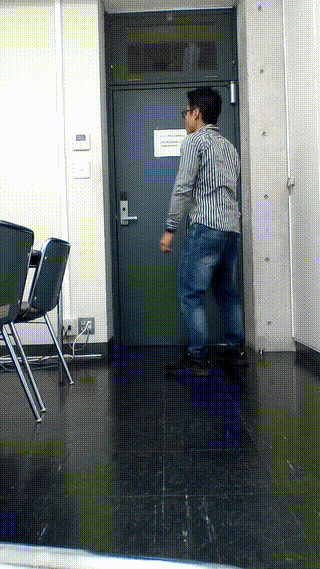

bad_head


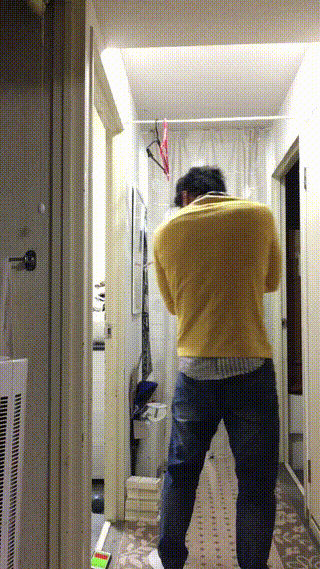

bad_back_warp


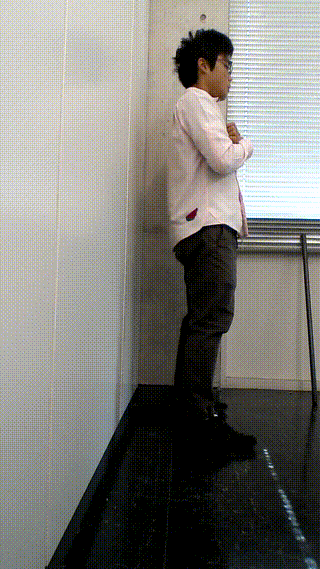

bad_back_round


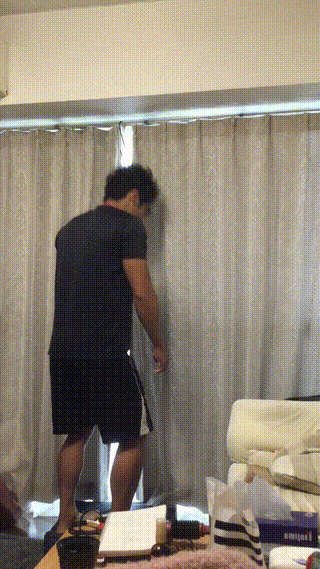

bad_inner_thigh


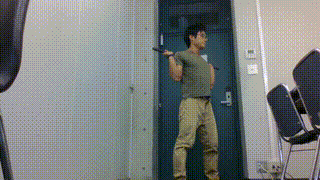

bad_toe


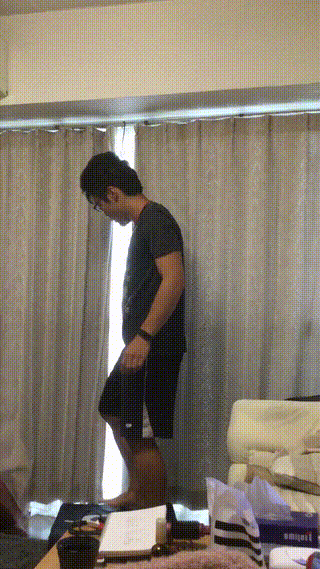

bad_shallow


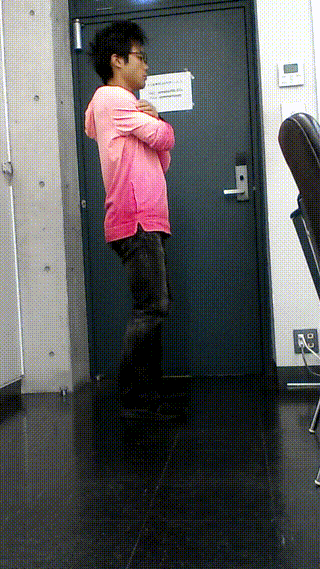

In [ ]:
import os
import random
import glob
import subprocess

# Iterate over each class
for class_name in SUB_CLASSES:
    # Get the list of video files for the current class
    folder_path = os.path.join(BASE_PATH, class_name)
    videos = glob.glob(os.path.join(folder_path, '*.mp4'))

    # Randomly choose a video
    random_video = random.choice(videos)

    # Create a directory for the current class if it doesn't exist
    class_directory = os.path.join(GIFS_PATH, class_name)
    os.makedirs(class_directory, exist_ok=True)

    # Generate a GIF for the randomly chosen video
    video_path = os.path.join(BASE_PATH, random_video)
    gif_file = os.path.splitext(random_video)[0] + ".gif"
    gif_path = os.path.join(class_directory, gif_file)

    # Generate the GIF using FFmpeg
    command = f'ffmpeg -i {video_path} -vf "fps=10,scale=320:-1:flags=lanczos" -c:v gif {gif_path}'
    subprocess.call(command, shell=True)

    # Display the generated GIF
    print(class_name)
    display(Image(filename=gif_path))


### Display the number of videos in each class


Number of videos in good: 256
Number of videos in bad_head: 264
Number of videos in bad_back_warp: 304
Number of videos in bad_back_round: 258
Number of videos in bad_inner_thigh: 224
Number of videos in bad_toe: 298
Number of videos in bad_shallow: 282


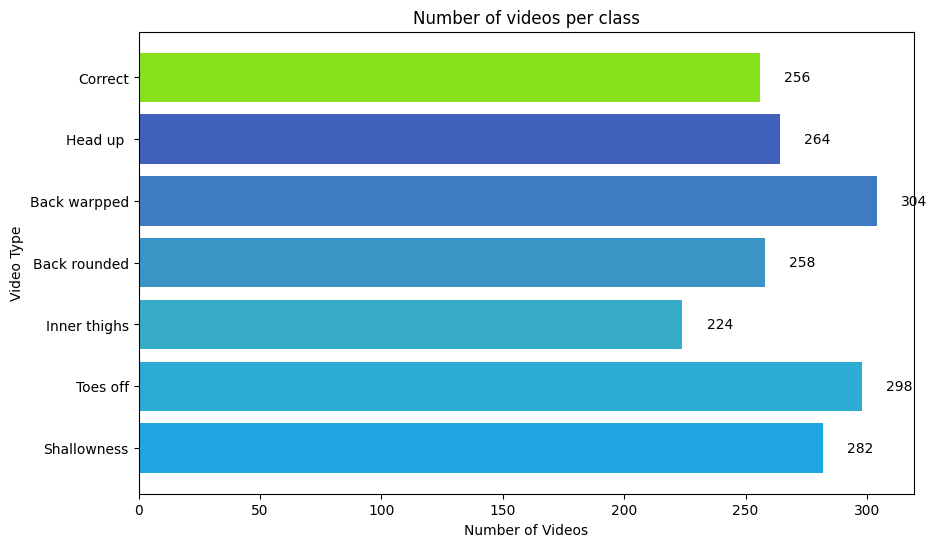

Total number of videos: 1886


In [ ]:
video_counts = []
for sub_class in SUB_CLASSES:
    sub_class_path = os.path.join(BASE_PATH, sub_class)
    video_count = len([file for file in os.listdir(sub_class_path) if not file.startswith("fli") and file.endswith(".mp4") ])
    video_counts.append(video_count)
    print(f"Number of videos in {sub_class}: {video_count}")

# Create a horizontal bar plot to visualize the video counts
fig, ax = plt.subplots(figsize=(10, 6))
y_pos = np.arange(len(SUB_CLASSES))
ax.barh(y_pos, video_counts, align='center', color=COLORS)
ax.set_yticks(y_pos)
ax.set_yticklabels(LABELS)
ax.invert_yaxis()  # Invert the y-axis to show categories from top to bottom
ax.set_xlabel('Number of Videos')
ax.set_ylabel('Video Type')
ax.set_title('Number of videos per class')

# Add the value labels to the bars
for i, v in enumerate(video_counts):
    ax.text(v + 10, i, str(v), color='black', va='center')

# Save the plot in the images folder with a specific filename
filename = 'NumberVideosPerClass.png'
filepath = os.path.join(FIG_PATH, filename)
plt.savefig(filepath)
plt.show()

# Print the total number of videos
print("Total number of videos:", sum(video_counts))



### Number of videos for each type after augmentation

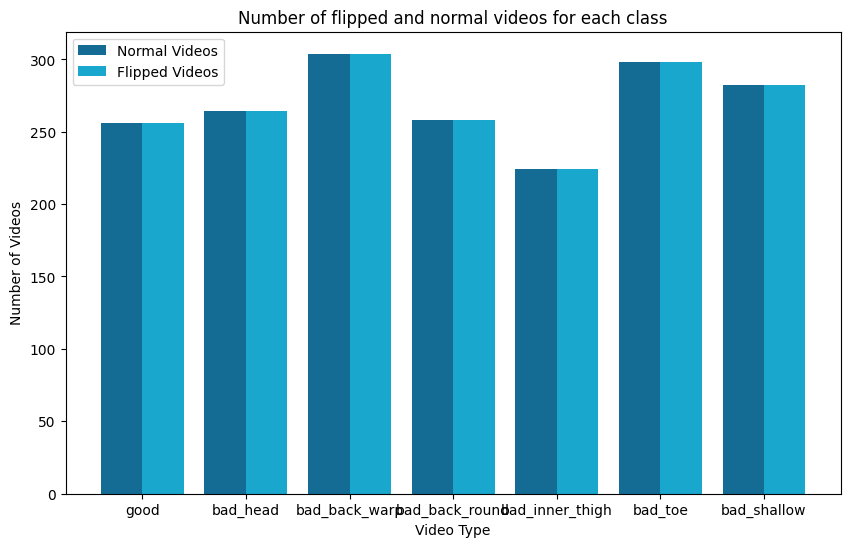

Total number of flipped videos: 1886
Total number of not flipped videos: 1886
['Correct', 'Head up ', 'Back warpped', 'Back rounded', 'Inner thighs', 'Toes off', 'Shallowness']
[256, 264, 304, 258, 224, 298, 282]
[512, 528, 608, 516, 448, 596, 564]


In [ ]:
video_counts = []
flipped_counts = []
not_flipped_counts = []

for folder_name in SUB_CLASSES:
    folder = os.path.join(BASE_PATH, folder_name)

    # Count the number of flipped videos
    flipped_count = len([file for file in os.listdir(folder) if file.startswith("fli") and file.endswith(".mp4") ])
    flipped_counts.append(flipped_count)

    # Count the number of not flipped videos
    not_flipped_count = len([file for file in os.listdir(folder) if not file.startswith("fli") and file.endswith(".mp4") ])
    not_flipped_counts.append(not_flipped_count)

# Create a bar chart to visualize the video counts with different colors
fig, ax = plt.subplots(figsize=(10, 6))

# Set the width of each bar
bar_width = 0.4

# Calculate the x positions for the bars
bar_positions = np.arange(len(SUB_CLASSES))


plt.bar(bar_positions - bar_width/2, flipped_counts, width=bar_width, color='#146C94', label='Normal Videos')
plt.bar(bar_positions + bar_width/2, not_flipped_counts, width=bar_width, color='#19A7CE', label='Flipped Videos')

plt.title("Number of flipped and normal videos for each class")
plt.xlabel("Video Type")
plt.ylabel("Number of Videos")
plt.xticks(bar_positions, SUB_CLASSES)
plt.legend()

# Save the plot in the images folder with a specific filename
filename = 'Number of Flipped and Not Flipped Videos for Each Type.png'
filepath = os.path.join(FIG_PATH, filename)
plt.savefig(filepath)
plt.show()

print("Total number of flipped videos:", sum(flipped_counts))
print("Total number of not flipped videos:", sum(not_flipped_counts))
print(LABELS)
print(flipped_counts)
print([x + y for x, y in zip(flipped_counts, not_flipped_counts)] )


### Video category distribution

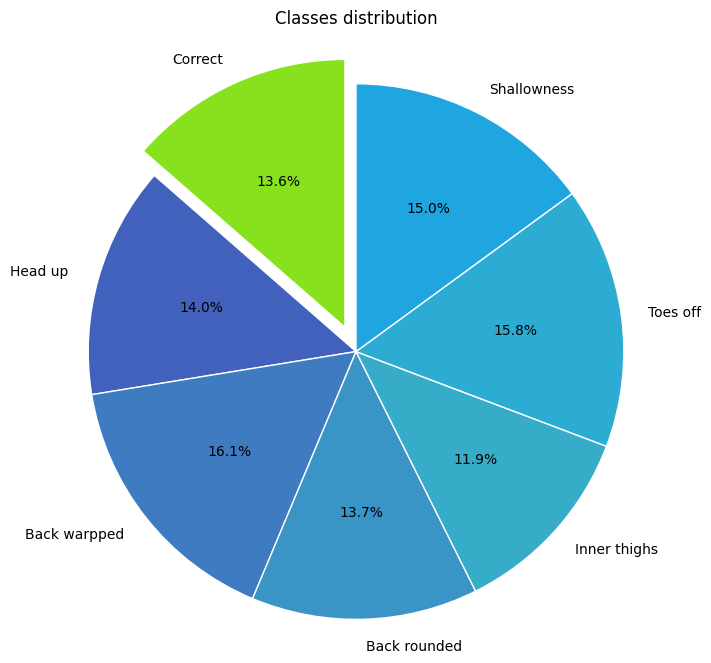

Total number of videos: 3772


In [ ]:
video_counts = []
for folder_name in SUB_CLASSES:
    folder = os.path.join(BASE_PATH, folder_name)
    video_count = len([file for file in os.listdir(folder) if file.endswith(".mp4")])
    video_counts.append(video_count)
# Create a pie chart to visualize the video counts
fig, ax = plt.subplots(figsize=(8, 8))
explode = (0.1, 0, 0, 0, 0, 0, 0)  # Explode the first slice (Category A) for emphasis
ax.pie(video_counts, explode=explode, labels=LABELS, colors=COLORS, autopct='%1.1f%%', shadow=False, startangle=90,wedgeprops={'edgecolor': 'white'})
ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle

# Set the title
plt.title("Classes distribution")

# Save the plot in the images folder with a specific filename
filename = 'Pie_Chart_Video_Category_Distribution.png'
filepath = os.path.join(FIG_PATH, filename)

plt.savefig(filepath)
plt.show()

print("Total number of videos:", sum(video_counts))

### Distribution of video lengths (frames)




In [ ]:
video_lengths = {}
for folder_name in SUB_CLASSES:
    folder = os.path.join(BASE_PATH, folder_name)
    video_lengths[folder_name] = []
    for video_file in os.listdir(folder):
        if video_file.endswith(".mp4"):
            video_path = os.path.join(folder, video_file)
            try:
                cap = cv2.VideoCapture(video_path)
                length = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
                video_lengths[folder_name].append(length)
                #print(f"Video {video_file} in folder {folder_name} has {length} frames")
                cap.release()
            except:
                print(f"Could not read video file: {video_path}")

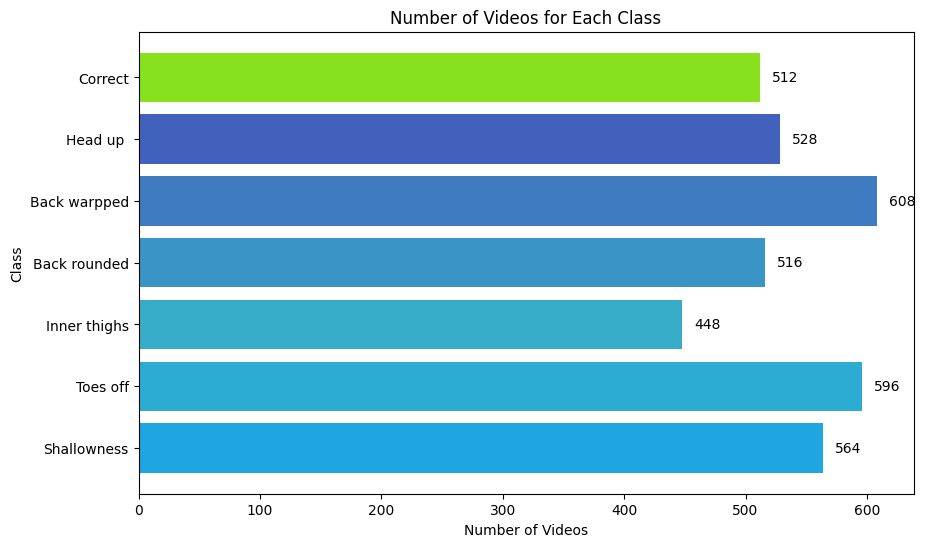

Total number of videos: 3772


In [ ]:
# Create a horizontal bar plot to visualize the video counts
fig, ax = plt.subplots(figsize=(10, 6))
y_pos = np.arange(len(SUB_CLASSES))
ax.barh(y_pos, video_counts, align='center', color=COLORS)
ax.set_yticks(y_pos)
ax.set_yticklabels(LABELS)
ax.invert_yaxis()  # Invert the y-axis to show categories from top to bottom
ax.set_xlabel('Number of Videos')
ax.set_ylabel('Class')
ax.set_title('Number of Videos for Each Class')

# Add the value labels to the bars
for i, v in enumerate(video_counts):
    ax.text(v + 10, i, str(v), color='black', va='center')

# Save the plot in the images folder with a specific filename
filename = 'Number of Videos for Each Type.png'
filepath = os.path.join(FIG_PATH, filename)
plt.savefig(filepath)
plt.show()

# Print the total number of videos
print("Total number of videos:", sum(video_counts))


In [ ]:
lengths = []
for folder_name in video_lengths.keys():
    lengths += video_lengths[folder_name]

/content/drive/Othercomputers/PFE/PFE2023/EDA/figures/Distribution of Video Lengths.png


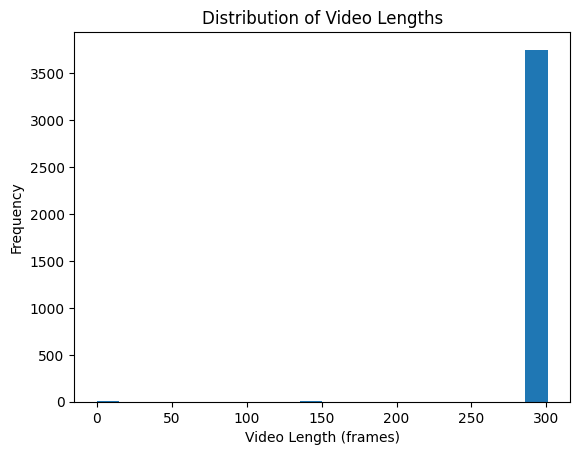

In [ ]:
# plot a histogram of the video lengths
plt.hist(lengths, bins=20)
plt.xlabel("Video Length (frames)")
plt.ylabel("Frequency")
plt.title("Distribution of Video Lengths")

# Save the plot in the images folder with a specific filename
filename = "Distribution of Video Lengths.png"
filepath = os.path.join(FIG_PATH, filename)
print(filepath)
plt.savefig(filepath)
plt.show()

## 3. Distribution of Video Resolutions


### Distribution of videos resolution

In [ ]:
resolutions = []

# Loop over each video in the folder
for folder_name in SUB_CLASSES:
    folder = os.path.join(BASE_PATH, folder_name)
    for video_file in os.listdir(folder):
        # Check if the file has a .mp4 extension
        if video_file.endswith(".mp4"):
            video_path = os.path.join(folder, video_file)
            cap = cv2.VideoCapture(video_path)
            width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
            height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
            resolutions.append((width, height))
            cap.release()

# Extract width and height into separate lists
widths, heights = zip(*resolutions)


/content/drive/Othercomputers/PFE/PFE2023/EDA/figures/Distribution_of_Video_Resolutions.png


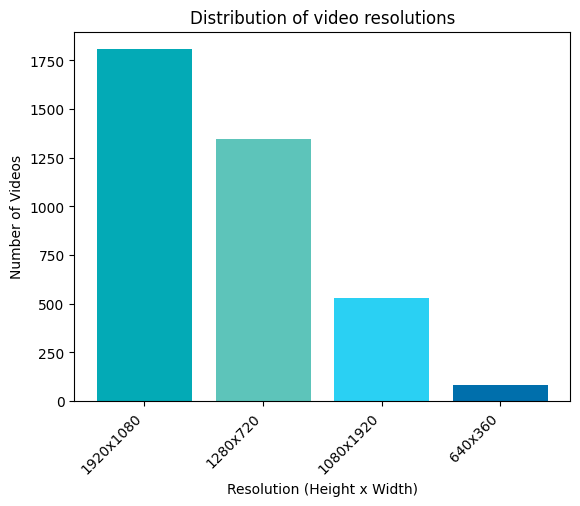

In [ ]:
import matplotlib.pyplot as plt
from collections import Counter

colors = ["#03aab6", "#5dc4ba", "#2ad0f3", "#006fac"]

# Remove 0x0 resolutions
resolutions = [(w, h) for w, h in resolutions if w != 0 and h != 0]

# Calculate the product of width and height for each video
resolutions_combined = [f"{height}x{width}" for width, height in resolutions]

# Count the occurrences of each resolution combination
resolution_counts = Counter(resolutions_combined)

# Extract the unique resolutions and their corresponding counts
unique_resolutions = list(resolution_counts.keys())
counts = list(resolution_counts.values())

# Create a bar plot of resolution counts
plt.bar(range(len(unique_resolutions)), counts, color=colors)

# Set the x-axis labels to the unique resolutions with rotation and alignment
plt.xticks(range(len(unique_resolutions)), unique_resolutions, rotation=45, ha='right')

# Set the labels and title
plt.xlabel("Resolution (Height x Width)")
plt.ylabel("Number of Videos")
plt.title("Distribution of video resolutions")

# Save the plot in the images folder with a specific filename
filename = "Distribution_of_Video_Resolutions.png"
filepath = os.path.join(FIG_PATH, filename)
print(filepath)
plt.savefig(filepath, dpi=300)  # Increase the DPI for higher resolution
plt.show()


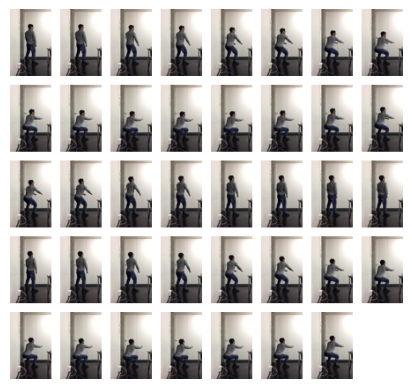

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt
import os

# Path to the folder containing the images
folder_path = "/content/drive/Othercomputers/PFE/PFE2023/data/Video_Dataset/good/flip_1025_squat_000001_folder380"



# Initialize an empty list to store the images
images = []

# Iterate over the files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        # Load each image and append it to the list
        image = Image.open(os.path.join(folder_path, filename))
        images.append(image)

# Set the size of the collage grid
num_images = len(images)
rows = 5  # Number of rows in the collage grid
cols = 8  # Number of columns in the collage grid

# Set the desired spacing between frames
spacing = 10  # Adjust this value as needed

# Calculate the size of each thumbnail image
thumbnail_width = images[0].size[0] // cols
thumbnail_height = images[0].size[1] // rows

# Calculate the size of each frame including the spacing
frame_width = thumbnail_width + spacing
frame_height = thumbnail_height + spacing

# Create a new blank image for the collage
collage_width = frame_width * cols - spacing
collage_height = frame_height * rows - spacing
collage = Image.new("RGB", (collage_width, collage_height),color='white')

# Iterate over the images and paste them into the collage with spacing
for i in range(num_images):
    # Resize each image to the thumbnail size
    thumbnail = images[i].resize((thumbnail_width, thumbnail_height))
    # Calculate the position to paste the thumbnail in the collage with spacing
    row = i // cols
    col = i % cols
    x = col * frame_width
    y = row * frame_height
    # Paste the thumbnail into the collage with spacing
    collage.paste(thumbnail, (x, y))

# Display the collage
plt.imshow(collage)
plt.axis('off')
plt.show()

## Conclusion
In this notebook, we conducted exploratory data analysis on the squat dataset. We analyzed various aspects of the data, including the distribution of videos in each class, the impact of augmentation on class distribution, the video category distribution, the distribution of video lengths, the variety of video resolutions, and the duration of videos. These insights can guide the preprocessing steps and model selection for the squat classification task.